# Climate Data Analysis and Modeling

## 1. Data Gathering
Using the Historical Weather API, the data is extracted for the following parameters:
- **Time range**: January 1940 - present
- **Variables**: 
  - Temperature (2m)
  - Precipitation (rain + snow)
- **Locations**:
  - Lugano
  - Additional cities of choice (to be defined)

we chose different cities based on the same latitute and longitude of Lugano

In [3]:
import pandas as pd
import geopy
import openmeteo_requests
import requests_cache
from retry_requests import retry
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import plotly.express as px
from retry_requests import retry
import statsmodels.api as sm          # Used to create the multiple linear regression at the end of the project


ModuleNotFoundError: No module named 'geopy'

In [26]:
import pandas as pd
import geopy
import openmeteo_requests
import requests_cache
from retry_requests import retry

# Boilerplate code for the auto-generated Open-Meteo API
cache_session = requests_cache.CachedSession(".cache", expire_after=-1)
retry_session = retry(cache_session, retries=5, backoff_factor=0.2)
openmeteo = openmeteo_requests.Client(session=retry_session)

#url = "https://archive-api.open-meteo.com/v1/archive"
def get_data(latitude, longitude, hourly):
    url = "https://customer-archive-api.open-meteo.com/v1/archive"
    params = {
    	"latitude": latitude,
    	"longitude": longitude,
    	"start_date": "1940-01-07",
    	"end_date": "2024-06-25",
    	"hourly": hourly,
    	"apikey": "5ftjs2VK6XVIpyYM"
    }
    responses = openmeteo.weather_api(url, params=params)
    
    # Process first location. Add a for-loop for multiple locations or weather models
    response = responses[0]
    print(f"Coordinates {response.Latitude()}°N {response.Longitude()}°E")
    print(f"Elevation {response.Elevation()} m asl")
    print(f"Timezone {response.Timezone()} {response.TimezoneAbbreviation()}")
    print(f"Timezone difference to GMT+0 {response.UtcOffsetSeconds()} s")
    
    # Process hourly data. The order of variables needs to be the same as requested.
    hourly = response.Hourly()
    hourly_temperature_2m = hourly.Variables(0).ValuesAsNumpy()
    hourly_precipitation = hourly.Variables(1).ValuesAsNumpy()
    hourly_cloud_cover = hourly.Variables(2).ValuesAsNumpy()
    hourly_sunshine_duration = hourly.Variables(3).ValuesAsNumpy()
    
    hourly_data = {"date": pd.date_range(
    	start = pd.to_datetime(hourly.Time(), unit = "s", utc = True),
    	end = pd.to_datetime(hourly.TimeEnd(), unit = "s", utc = True),
    	freq = pd.Timedelta(seconds = hourly.Interval()),
    	inclusive = "left"
    )}
    hourly_data["temperature_2m"] = hourly_temperature_2m
    hourly_data["precipitation"] = hourly_precipitation
    
    hourly_dataframe = pd.DataFrame(data = hourly_data)
    
    return hourly_dataframe

### creation of the different dataframe

In [27]:
variables = ["temperature_2m", "precipitation"]

lugano_lat = 46.003
lugano_lon = 8.951

los_angeles_lat = 34.05
los_angeles_lon = -118.24

montreal_lat = 45.51
montreal_lon = -73.59

genova_lat = 44.40
genova_lon = 8.94


lugano_dataframe = get_data(lugano_lat, lugano_lon, variables)
losangeles_dataframe = get_data(los_angeles_lat, los_angeles_lon, variables)
montreal_dataframe = get_data(montreal_lat, montreal_lon, variables)
genova_dataframe = get_data(genova_lat, genova_lon, variables)

Coordinates 46.01054382324219°N 8.85714340209961°E
Elevation 284.0 m asl
Timezone None None
Timezone difference to GMT+0 0 s
Coordinates 34.05975341796875°N -118.23750305175781°E
Elevation 87.0 m asl
Timezone None None
Timezone difference to GMT+0 0 s
Coordinates 45.51845169067383°N -73.751953125°E
Elevation 163.0 m asl
Timezone None None
Timezone difference to GMT+0 0 s
Coordinates 44.393672943115234°N 9.096477508544922°E
Elevation 45.0 m asl
Timezone None None
Timezone difference to GMT+0 0 s


In [28]:
lugano_dataframe


,date,temperature_2m,precipitation
0,1940-01-07 00:00:00+00:00,-0.572500,0.0
1,1940-01-07 01:00:00+00:00,-1.322500,0.0
2,1940-01-07 02:00:00+00:00,-1.622500,0.0
3,1940-01-07 03:00:00+00:00,-1.372500,0.0
4,1940-01-07 04:00:00+00:00,-1.372500,0.0
...,...,...,...
740443,2024-06-25 19:00:00+00:00,21.442001,0.0
740444,2024-06-25 20:00:00+00:00,20.742001,0.0
740445,2024-06-25 21:00:00+00:00,20.142000,0.0
740446,2024-06-25 22:00:00+00:00,19.742001,0.0


In [29]:
# function for the yearly mean of the data
def yearly_mean_df(dataframe):
    df = dataframe.copy()
    df['date'] = pd.to_datetime(df['date'])
    df['year'] = df['date'].dt.year
    df.set_index('date', inplace=True)
    yearly_df = df.resample('YE').mean()
    yearly_df.reset_index(inplace=True)
    return yearly_df



In [30]:
# function for the yearly sum of the data
def yearly_sum_df(dataframe):
    df = dataframe.copy()
    df['date'] = pd.to_datetime(df['date'])
    df['year'] = df['date'].dt.year
    df.set_index('date', inplace=True)
    yearly_df = df.resample('Y').sum(numeric_only=True)
    yearly_df['year'] = yearly_df.index.year
    yearly_df.reset_index(drop=True, inplace=True)
    yearly_df = yearly_df[['year', 'precipitation', 'temperature_2m']]
    return yearly_df


## Data Visualisation

In [31]:
lugano_yearly = yearly_mean_df(lugano_dataframe)
losangeles_yearly = yearly_mean_df(losangeles_dataframe)
montreal_yearly = yearly_mean_df(montreal_dataframe)
genova_yearly = yearly_mean_df(genova_dataframe)

Yearly Analysis

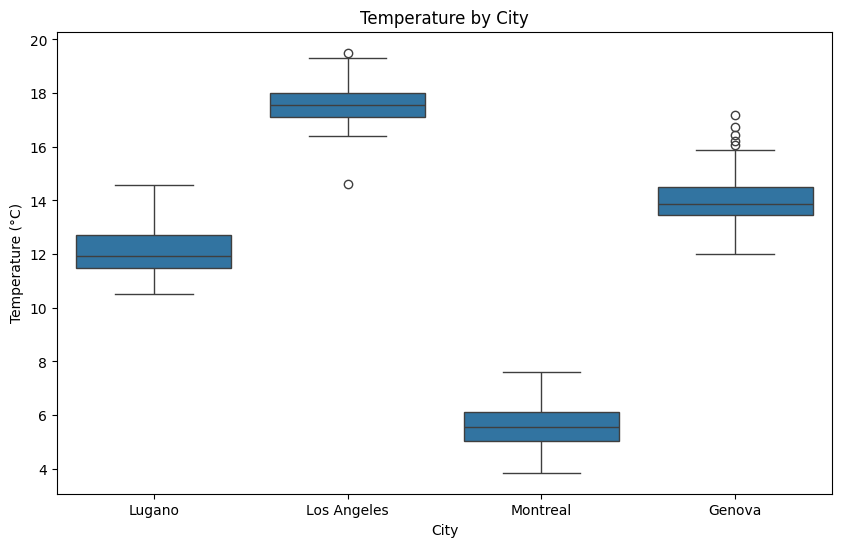

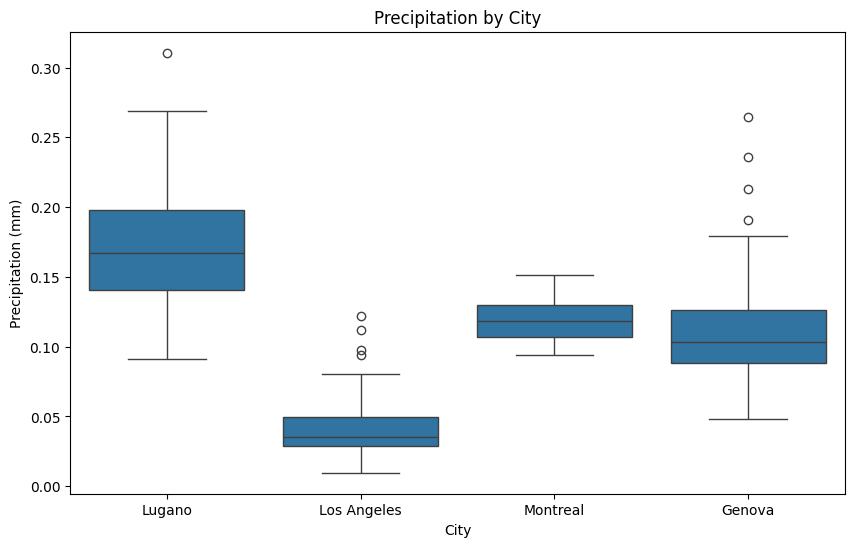

In [32]:

# Aggiungere una colonna per la città in ciascun dataframe
lugano_yearly['City'] = 'Lugano'
losangeles_yearly['City'] = 'Los Angeles'
montreal_yearly['City'] = 'Montreal'
genova_yearly['City'] = 'Genova'

# Combinare i dataframe in un unico dataframe
combined_df = pd.concat([lugano_yearly, losangeles_yearly, montreal_yearly, genova_yearly])

# Creare i boxplot per la temperatura
plt.figure(figsize=(10, 6))
sns.boxplot(x='City', y='temperature_2m', data=combined_df)
plt.title('Temperature by City')
plt.xlabel('City')
plt.ylabel('Temperature (°C)')
plt.show()

# Creare i boxplot per le precipitazioni
plt.figure(figsize=(10, 6))
sns.boxplot(x='City', y='precipitation', data=combined_df)
plt.title('Precipitation by City')
plt.xlabel('City')
plt.ylabel('Precipitation (mm)')
plt.show()

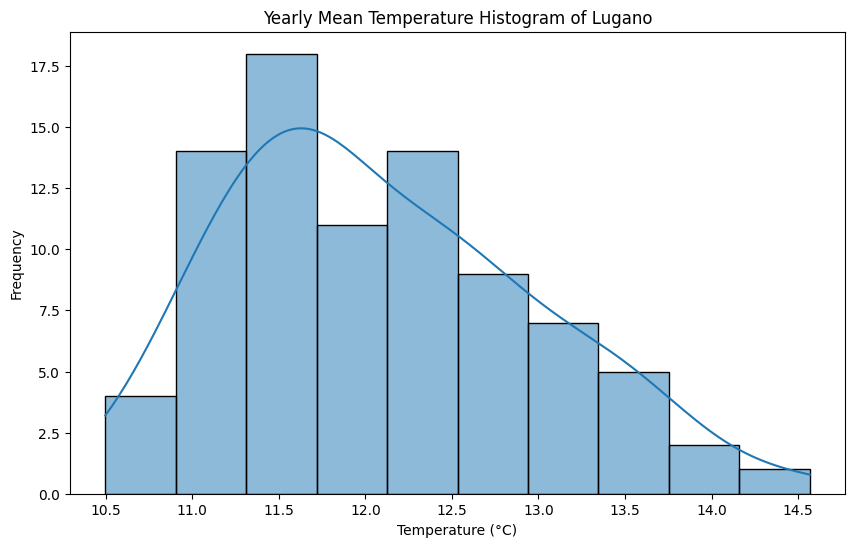

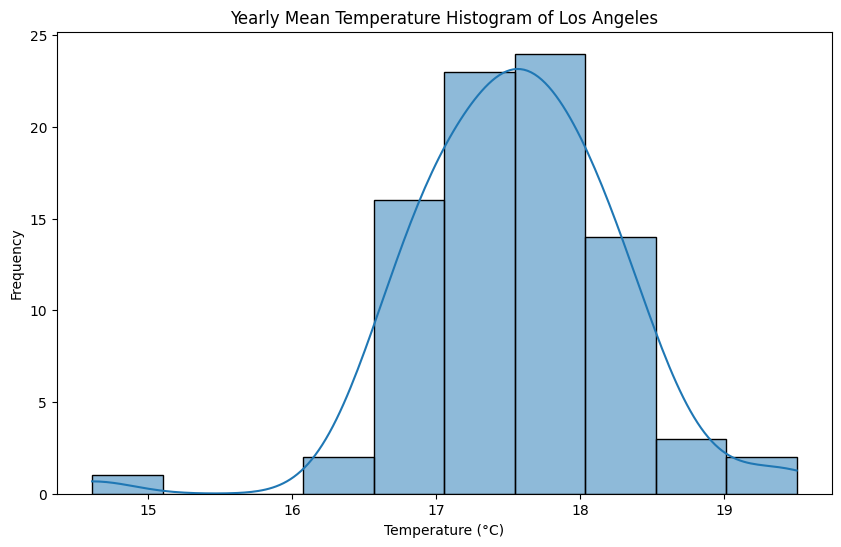

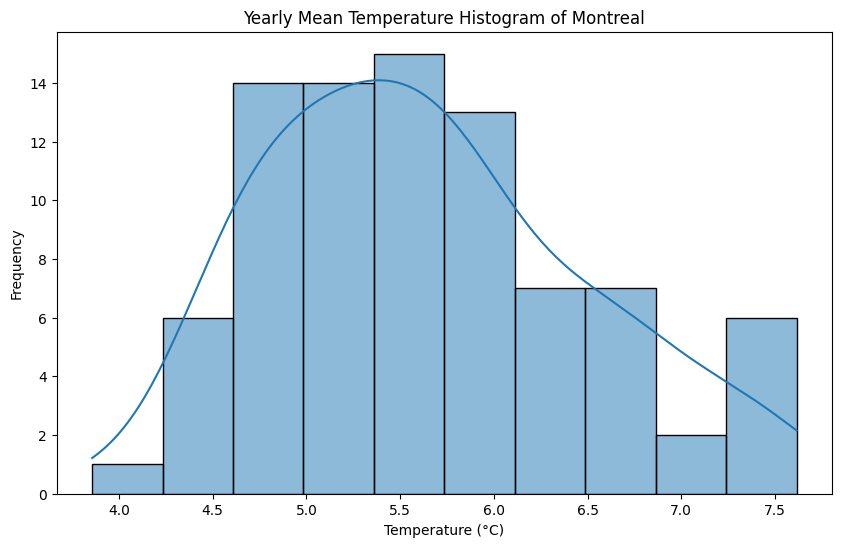

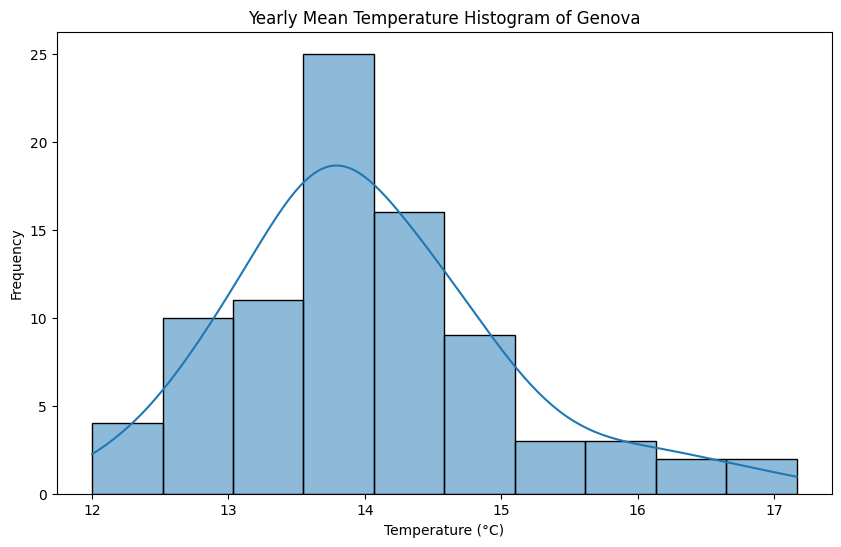

In [33]:
def plot_yearly_temperature_histogram(dataframe, city_name):
    df_yearly = yearly_mean_df(dataframe)
    plt.figure(figsize=(10, 6))
    sns.histplot(df_yearly['temperature_2m'], bins=10, kde=True)
    plt.title(f'Yearly Mean Temperature Histogram of {city_name}')
    plt.xlabel('Temperature (°C)')
    plt.ylabel('Frequency')
    plt.show()

# Lugano
plot_yearly_temperature_histogram(lugano_dataframe, 'Lugano')

# Los Angeles
plot_yearly_temperature_histogram(losangeles_dataframe, 'Los Angeles')

# Montreal
plot_yearly_temperature_histogram(montreal_dataframe, 'Montreal')

# Genova
plot_yearly_temperature_histogram(genova_dataframe, 'Genova')

In [34]:
# creare grafico unico con le 4 città
df_yearly_lugano = yearly_mean_df(lugano_dataframe)
df_yearly_lugano["city"] = "Lugano"

df_yearly_montreal = yearly_mean_df(montreal_dataframe)
df_yearly_montreal["city"] = "Montreal"

df_yearly_losangeles = yearly_mean_df(losangeles_dataframe)
df_yearly_losangeles["city"] = "Los Angeles"

df_yearly_genova = yearly_mean_df(genova_dataframe)
df_yearly_genova["city"] = "Genova"

df_merged = pd.concat([df_yearly_lugano, df_yearly_montreal, df_yearly_losangeles, df_yearly_genova])
df_merged

fig = px.line(df_merged, x="date", y="temperature_2m", color="city")
fig.show()

fig = px.line(df_merged, x="date", y="precipitation", color="city")
fig.show()

C:\Users\ms\AppData\Local\Temp\ipykernel_25372\2092775865.py:7: FutureWarning:

'Y' is deprecated and will be removed in a future version, please use 'YE' instead.

C:\Users\ms\AppData\Local\Temp\ipykernel_25372\2092775865.py:7: FutureWarning:

'Y' is deprecated and will be removed in a future version, please use 'YE' instead.

C:\Users\ms\AppData\Local\Temp\ipykernel_25372\2092775865.py:7: FutureWarning:

'Y' is deprecated and will be removed in a future version, please use 'YE' instead.

C:\Users\ms\AppData\Local\Temp\ipykernel_25372\2092775865.py:7: FutureWarning:

'Y' is deprecated and will be removed in a future version, please use 'YE' instead.



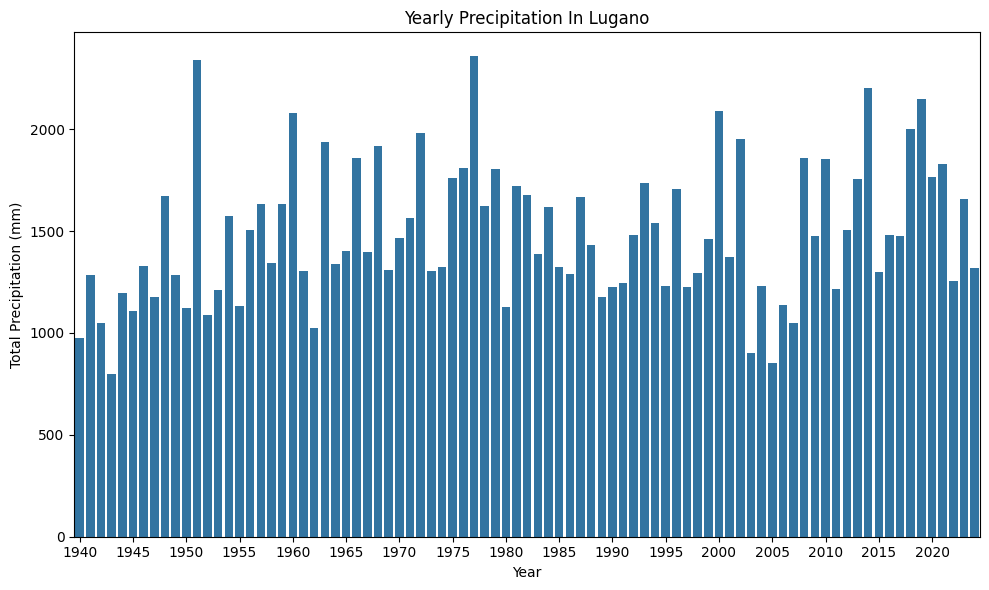

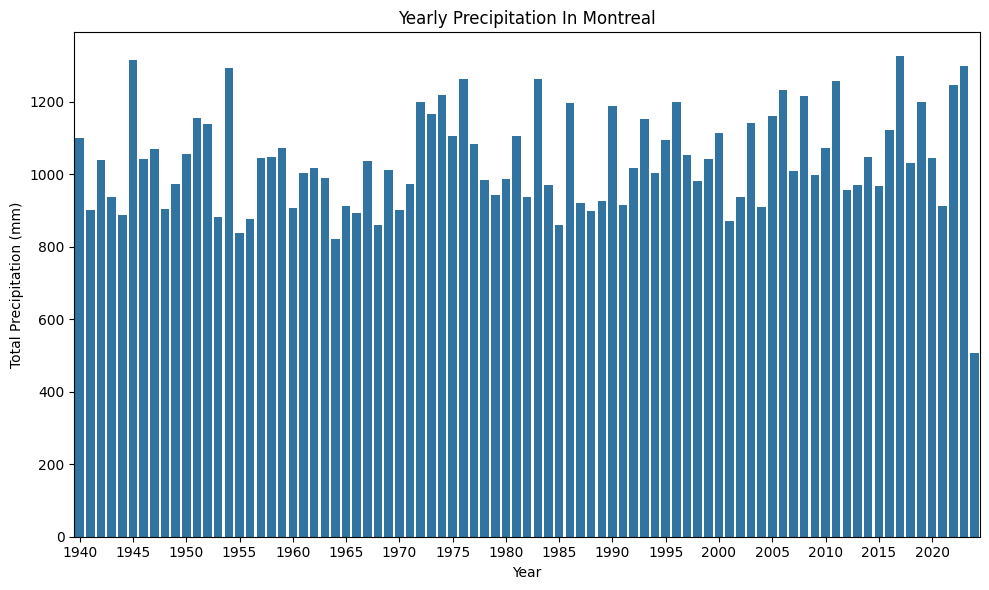

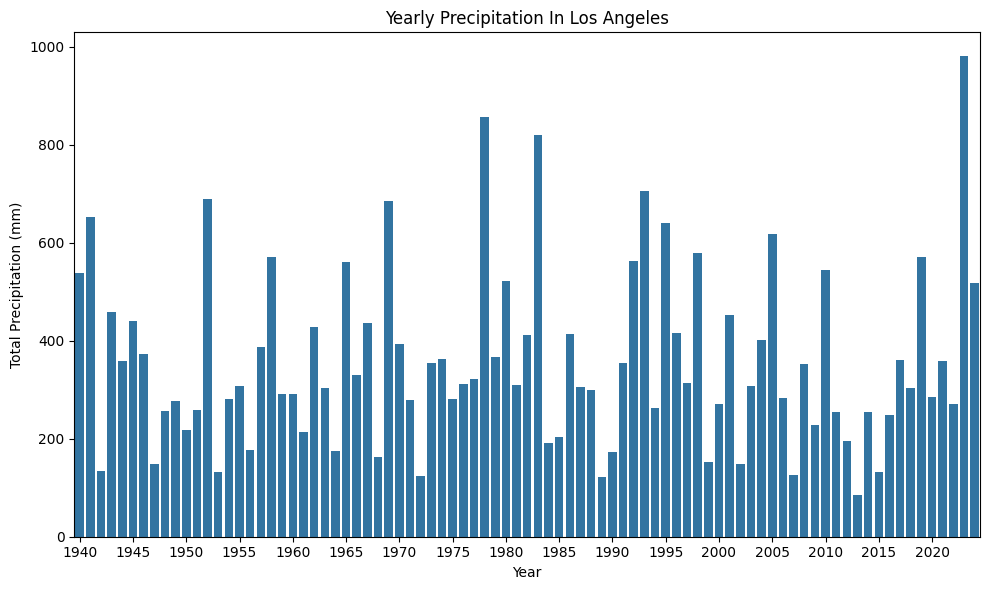

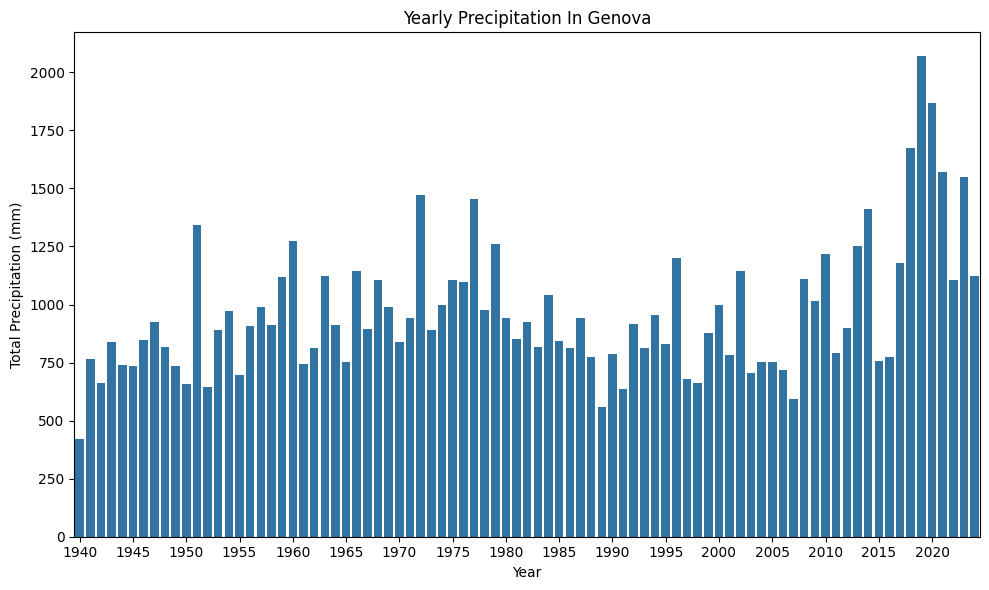

In [35]:
df_yearly_sum_lugano = yearly_sum_df(lugano_dataframe)
df_yearly_sum_montreal = yearly_sum_df(montreal_dataframe)
df_yearly_sum_genova = yearly_sum_df(genova_dataframe)
df_yearly_sum_losangeles = yearly_sum_df(losangeles_dataframe)

def yearly_precipitation_plot(dataframe, info):
    # histogramma per le 4 cittâ
    plt.figure(figsize=(10, 6))
    ax = sns.barplot(x='year', y='precipitation', data=dataframe)
    plt.title('Yearly Precipitation In ' + info)
    plt.xlabel('Year')
    plt.ylabel('Total Precipitation (mm)')
    
    # Migliorare le etichette sull'asse x
    ax.set_xticks(ax.get_xticks()[::5])
    
    plt.tight_layout()
    plt.show()

yearly_precipitation_plot(df_yearly_sum_lugano, "Lugano")
yearly_precipitation_plot(df_yearly_sum_montreal, "Montreal")
yearly_precipitation_plot(df_yearly_sum_losangeles, "Los Angeles")
yearly_precipitation_plot(df_yearly_sum_genova, "Genova")


In [36]:
df_filtered = yearly_sum_df(lugano_dataframe)[yearly_sum_df(lugano_dataframe)['year'].isin([2022, 2024])]
# Ottenere i valori di precipitazione per gli anni 2022 e 2024
precip_2022 = df_filtered[df_filtered['year'] == 2022]['precipitation'].values[0]
precip_2024 = df_filtered[df_filtered['year'] == 2024]['precipitation'].values[0]

# Stampare i risultati in un formato leggibile
print(f"Precipitation for the 2022: {precip_2022:.2f} mm")
print(f"Precipitation for the 2024: {precip_2024:.2f} mm until now")

Precipitation for the 2022: 1254.20 mm
Precipitation for the 2024: 1319.50 mm until now


C:\Users\ms\AppData\Local\Temp\ipykernel_25372\2092775865.py:7: FutureWarning:

'Y' is deprecated and will be removed in a future version, please use 'YE' instead.

C:\Users\ms\AppData\Local\Temp\ipykernel_25372\2092775865.py:7: FutureWarning:

'Y' is deprecated and will be removed in a future version, please use 'YE' instead.



Monthly Analysis

In [37]:
def monthly_mean_df(dataframe):
    df = dataframe.copy()
    df['date'] = pd.to_datetime(df['date'])
    df.set_index('date', inplace=True)
    monthly_df = df.resample('ME').mean()
    monthly_df.reset_index(inplace=True)
    return monthly_df

In [38]:
def monthly_sum_df(dataframe):
    df = dataframe.copy()
    df['date'] = pd.to_datetime(df['date'])
    df.set_index('date', inplace=True)
    monthly_df = df.resample('ME').sum()
    monthly_df.reset_index(inplace=True)
    return monthly_df

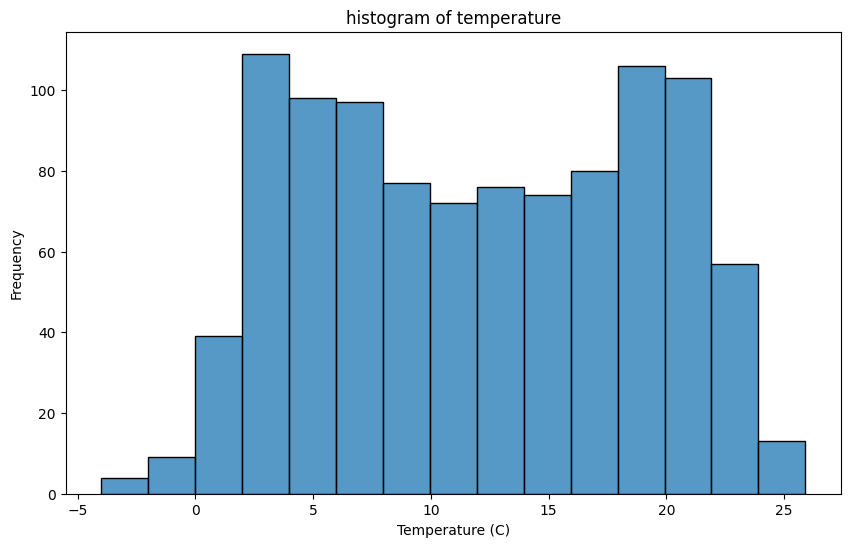

In [39]:
plt.figure(figsize=(10, 6))
sns.histplot(monthly_mean_df(lugano_dataframe)['temperature_2m'], bins=15, kde=False)
plt.title('histogram of temperature')
plt.xlabel('Temperature (C)')
plt.ylabel('Frequency')
plt.show()

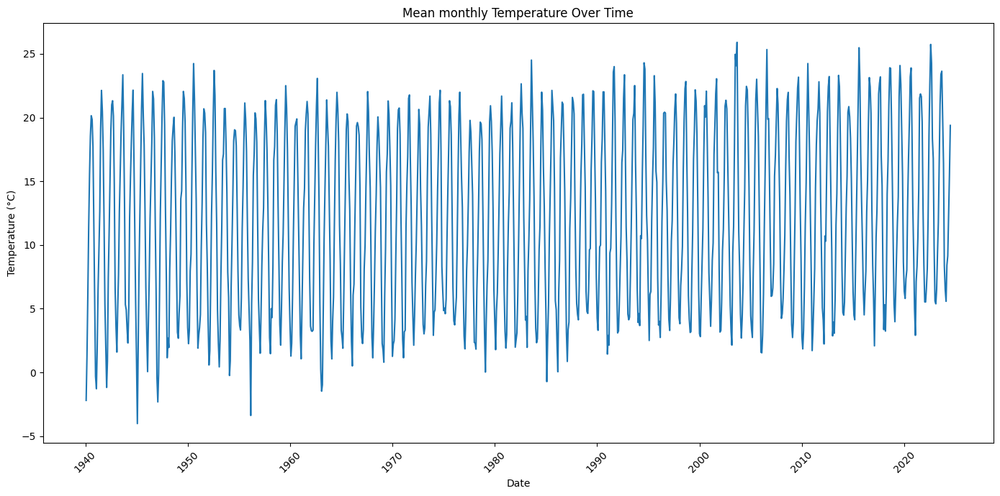

In [40]:
plt.figure(figsize=(14, 7))
sns.lineplot(x=monthly_mean_df(lugano_dataframe)['date'], y=monthly_mean_df(lugano_dataframe)['temperature_2m'])
plt.title('Mean monthly Temperature Over Time')
plt.xlabel('Date')
plt.ylabel('Temperature (°C)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [41]:
def add_date_columns(dataframe):
    df = dataframe.copy()
    df["date"] = pd.to_datetime(df["date"])
    df["year"] = df["date"].dt.year
    df["month"] = df["date"].dt.month
    df["day"] = df["date"].dt.day
    return df


lugano_year = add_date_columns(lugano_dataframe)
fig = px.histogram(lugano_year, x="month", y="temperature_2m", animation_frame="year")
fig.show()

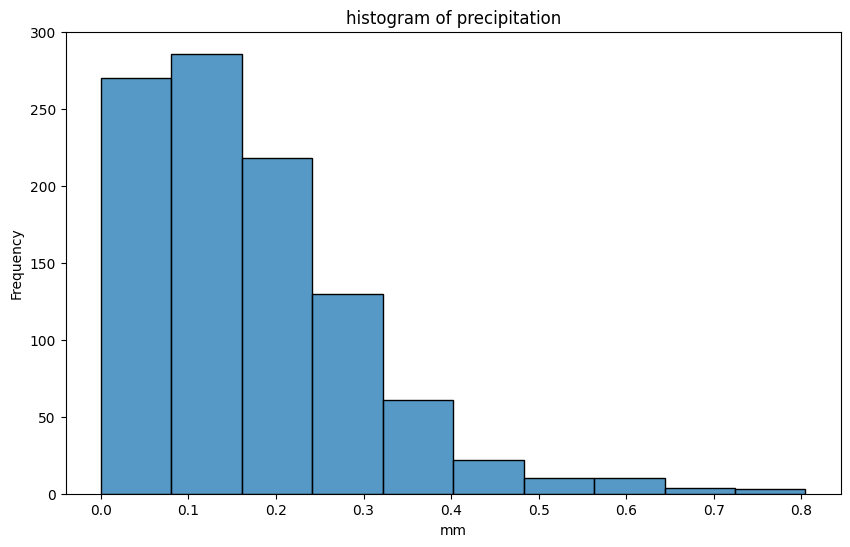

In [42]:
plt.figure(figsize=(10, 6))
sns.histplot(monthly_mean_df(lugano_dataframe)['precipitation'], bins=10, kde=False)
plt.title('histogram of precipitation')
plt.xlabel('mm')
plt.ylabel('Frequency')
plt.show()

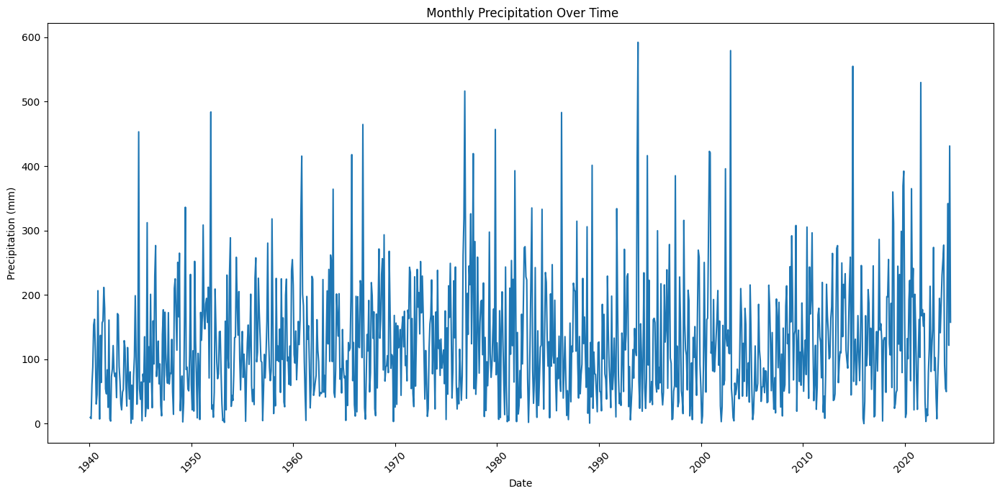

In [43]:
plt.figure(figsize=(14, 7))
sns.lineplot(x=monthly_sum_df(lugano_dataframe)['date'], y=monthly_sum_df(lugano_dataframe)['precipitation'])
plt.title(' Monthly Precipitation Over Time')
plt.xlabel('Date')
plt.ylabel('Precipitation (mm)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

## Linear regression modeling

In [44]:
# Ensure 'date' is a datetime type
lugano_dataframe['date'] = pd.to_datetime(lugano_dataframe['date'])

# Convert 'date' to a numeric format
lugano_dataframe['date_numeric'] = (lugano_dataframe['date'] - lugano_dataframe['date'].min()).dt.days

lugano_dataframe_mday = lugano_dataframe.groupby("date_numeric", as_index=False)["temperature_2m"].mean() # Temperature averaged by year

# Define the model
mod = sm.OLS(lugano_dataframe['temperature_2m'], sm.add_constant(lugano_dataframe['date_numeric']))

# Fit the model
fitted_mod = mod.fit()

# Print the summary
print(fitted_mod.summary(), '\n')

# Print the adjusted R-squared value
print("The value of Adjusted R2 that we need to overcome is: ", fitted_mod.rsquared_adj)

                            OLS Regression Results                            
Dep. Variable:         temperature_2m   R-squared:                       0.008
Model:                            OLS   Adj. R-squared:                  0.008
Method:                 Least Squares   F-statistic:                     5739.
Date:                Thu, 27 Jun 2024   Prob (F-statistic):               0.00
Time:                        14:20:22   Log-Likelihood:            -2.5745e+06
No. Observations:              740448   AIC:                         5.149e+06
Df Residuals:                  740446   BIC:                         5.149e+06
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
const           10.9053      0.018    599.186   

In [45]:
# Define the model
df_yearly = yearly_mean_df(lugano_dataframe)
mod = sm.OLS(df_yearly['temperature_2m'], sm.add_constant(df_yearly['date_numeric']))

# Fit the model
fitted_mod = mod.fit()

# Print the summary
print(fitted_mod.summary(), '\n')

# Print the adjusted R-squared value
print("The value of Adjusted R2 that we need to overcome is: ", fitted_mod.rsquared_adj)


                            OLS Regression Results                            
Dep. Variable:         temperature_2m   R-squared:                       0.556
Model:                            OLS   Adj. R-squared:                  0.551
Method:                 Least Squares   F-statistic:                     104.0
Date:                Thu, 27 Jun 2024   Prob (F-statistic):           2.63e-16
Time:                        14:20:22   Log-Likelihood:                -75.100
No. Observations:                  85   AIC:                             154.2
Df Residuals:                      83   BIC:                             159.1
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
const           10.9606      0.129     85.295   

In [46]:
def prediction_model(latitude, longitude):
    # The order of variables in hourly or daily is important to assign them correctly below
    #url = "https://climate-api.open-meteo.com/v1/climate"
    url = "https://customer-climate-api.open-meteo.com/v1/climate"
    params = {
    	"latitude": latitude,
    	"longitude": longitude,
    	"start_date": "2024-01-01",
    	"end_date": "2050-12-31",
    	"models": ["CMCC_CM2_VHR4", "FGOALS_f3_H", "HiRAM_SIT_HR", "MRI_AGCM3_2_S", "EC_Earth3P_HR", "MPI_ESM1_2_XR", "NICAM16_8S"],
    	"daily": ["temperature_2m_mean", "precipitation_sum"],
        "apikey": "5ftjs2VK6XVIpyYM" # commercial API key, with more tokens available than the free API key
    }
    responses = openmeteo.weather_api(url, params=params)
    
    # Process first location. Add a for-loop for multiple locations or weather models
    response = responses[0]
    print(f"Coordinates {response.Latitude()}°N {response.Longitude()}°E")
    print(f"Elevation {response.Elevation()} m asl")
    print(f"Timezone {response.Timezone()} {response.TimezoneAbbreviation()}")
    print(f"Timezone difference to GMT+0 {response.UtcOffsetSeconds()} s")
    
    # Process daily data. The order of variables needs to be the same as requested.
    daily = response.Daily()
    daily_temperature_2m_mean = daily.Variables(0).ValuesAsNumpy()
    daily_precipitation_mean = daily.Variables(1).ValuesAsNumpy()
    
    daily_data = {"date": pd.date_range(
    	start = pd.to_datetime(daily.Time(), unit = "s", utc = True),
    	end = pd.to_datetime(daily.TimeEnd(), unit = "s", utc = True),
    	freq = pd.Timedelta(seconds = daily.Interval()),
    	inclusive = "left"
    )}
    daily_data["temperature_2m_mean"] = daily_temperature_2m_mean
    daily_data["daily_precipitation_mean"] = daily_precipitation_mean
    
    daily_dataframe = pd.DataFrame(data = daily_data)
    
    return daily_dataframe

lugano_lat = 46.003
lugano_lon = 8.951


Coordinates 45.90000915527344°N 8.900009155273438°E
Elevation 284.0 m asl
Timezone None None
Timezone difference to GMT+0 0 s


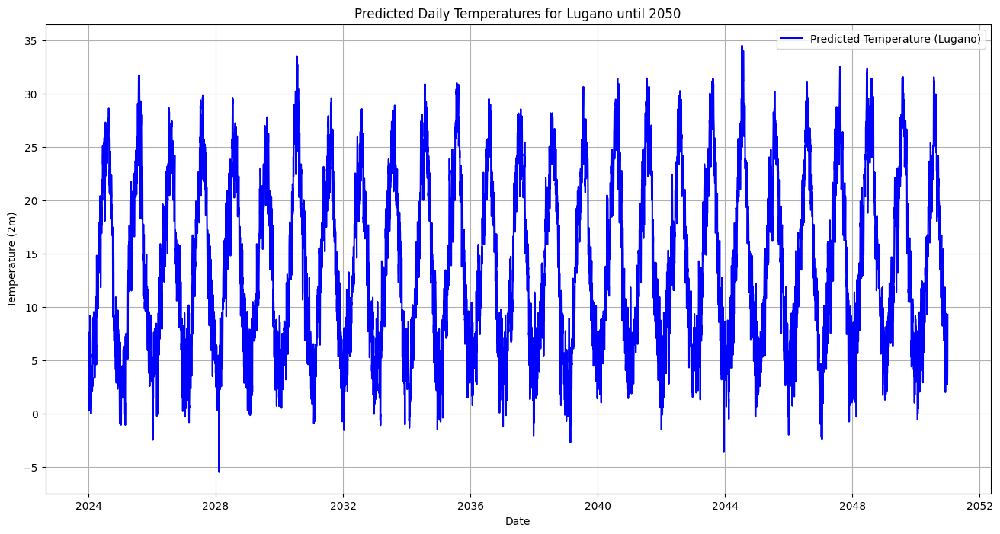

In [47]:
# get predictions for Lugano
prediction_lugano = prediction_model(lugano_lat, lugano_lon)
prediction_lugano_mean = yearly_mean_df(prediction_lugano)

# Plot predicted daily temperatures for Lugano until 2050
plt.figure(figsize=(16, 8))
plt.plot(prediction_lugano['date'], prediction_lugano['temperature_2m_mean'], color='blue', label='Predicted Temperature (Lugano)')
plt.xlabel('Date')
plt.ylabel('Temperature (2m)')
plt.title('Predicted Daily Temperatures for Lugano until 2050')
plt.legend()
plt.grid(True)
plt.show()


C:\Users\ms\AppData\Local\Temp\ipykernel_25372\3872256371.py:3: FutureWarning:

'Y' is deprecated and will be removed in a future version, please use 'YE' instead.



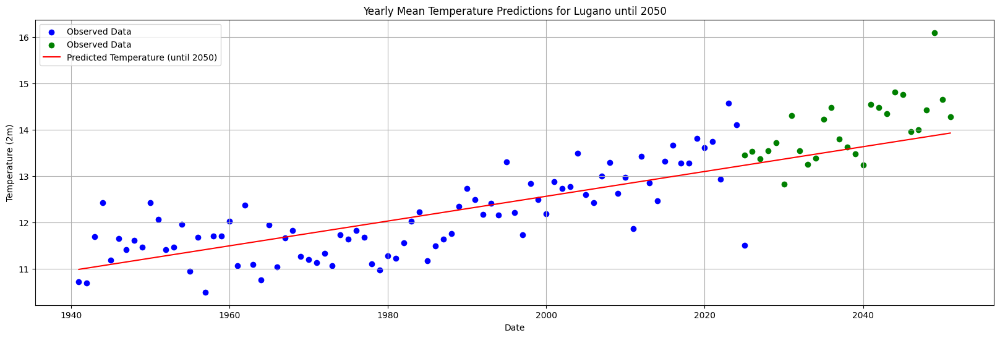

In [48]:
df_yearly_mean = yearly_mean_df(lugano_dataframe)
# Dates until 2050 for prediction
future_dates = pd.date_range(start='1940-01-01', end='2050-12-31', freq='Y').tz_localize('UTC')

# Convert future dates to numeric format
future_dates_numeric = (future_dates - lugano_dataframe['date'].min()).days

# Create a DataFrame for predicted temperatures
predicted_data = pd.DataFrame({'date': future_dates, 'date_numeric': future_dates_numeric})

# Predict future temperatures using the fitted model
predicted_data['predicted_temp'] = fitted_mod.predict(sm.add_constant(predicted_data['date_numeric']))

# Combine yearly mean data and predicted data
combined_data = pd.concat([df_yearly[['date', 'temperature_2m']], predicted_data[['date', 'predicted_temp']]], ignore_index=True)

# Plotting
plt.figure(figsize=(20, 6))

# Plot observed yearly mean temperatures
plt.scatter(df_yearly['date'], df_yearly['temperature_2m'], color='blue', label='Observed Data')

# Plot prediction API yearly mean temperatures
plt.scatter(prediction_lugano_mean['date'], prediction_lugano_mean['temperature_2m_mean'], color='green', label='Observed Data')

# Plot predicted temperatures
plt.plot(predicted_data['date'], predicted_data['predicted_temp'], color='red', label='Predicted Temperature (until 2050)')

# Plot settings
plt.xlabel('Date')
plt.ylabel('Temperature (2m)')
plt.title('Yearly Mean Temperature Predictions for Lugano until 2050')
plt.legend()
plt.grid(True)
plt.show()